In [11]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as td
import torchvision as tv
from PIL import Image
import matplotlib.pyplot as plt
from original_NST import run_style_transfer
from train_transformer import *

In [2]:
image_size = (512, 512)
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


### Different choice of iteration number

number of steps = 300content weight = 1 style weight = 10000000.0


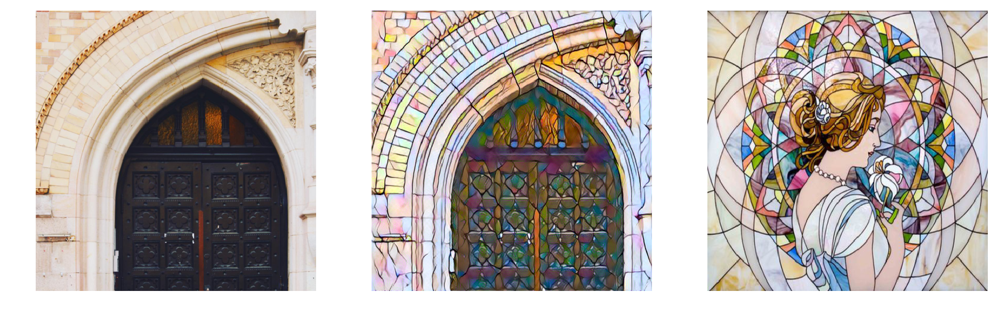

In [25]:
nstep, sw, cw = 300, 10e6, 1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 700 content weight = 1 style weight = 10000000.0


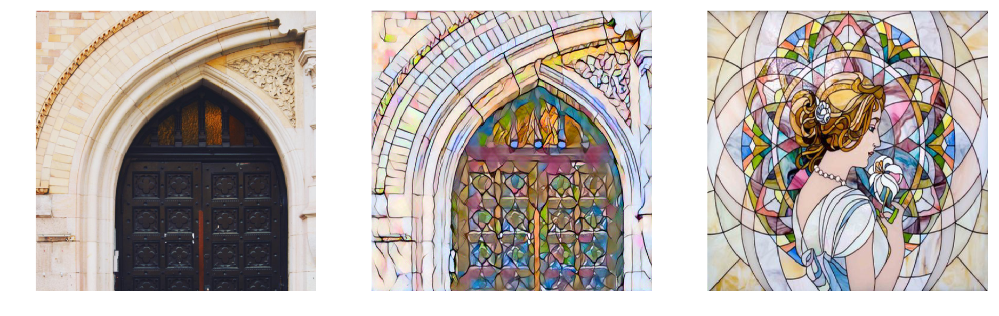

In [28]:
nstep, sw, cw = 700, 10e6, 1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 1 style weight = 10000000.0


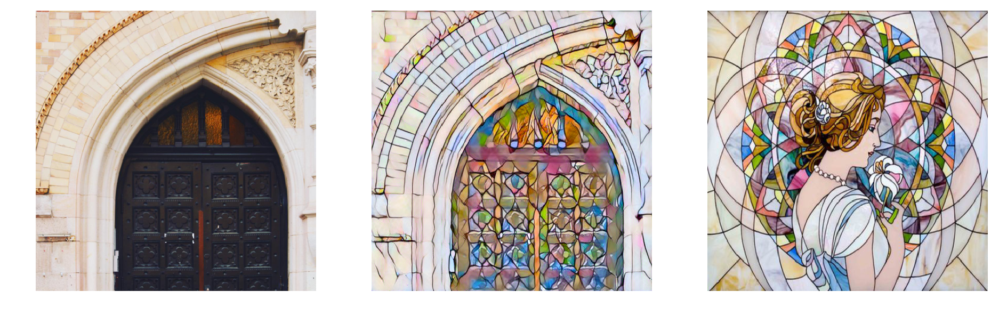

In [29]:
nstep, sw, cw = 1000, 10e6, 1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 2000 content weight = 1 style weight = 10000000.0


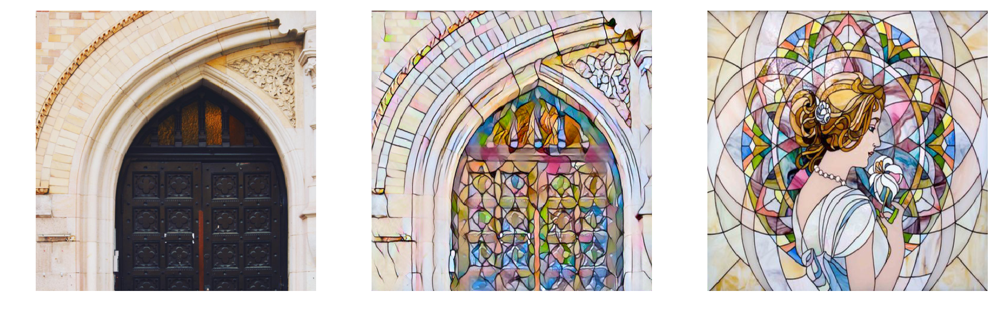

In [30]:
nstep, sw, cw = 2000, 10e6, 1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))


### Conclusion
When number of steps is below 1000, the output image will become more stylized as the number of steps increases. When number of steps cross 1000, the results remain relatively stable. So for getting different stylized effect, besides choosing different weights of style and content, we can also tuning number of iterations.

### Different choice of style weight and content weight
For examing effect of different style/content weight ratio, we choose 1000 as number of iterations, which could stablize the results, enable us to visualize output of different choice of weight ratio.

number of steps = 1000 content weight = 1 style weight = 10000000.0


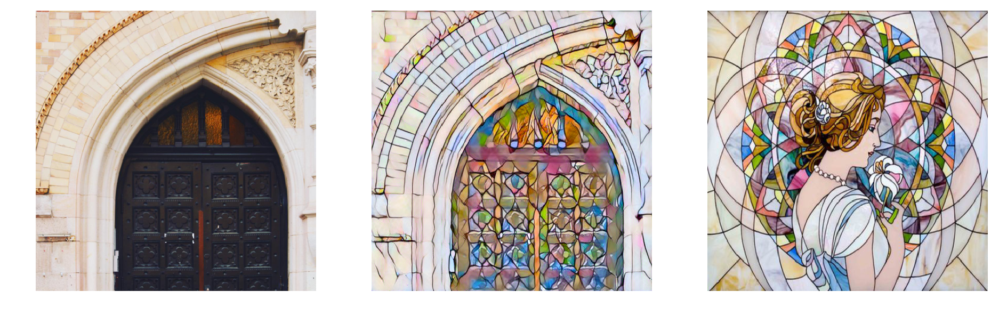

In [35]:
nstep, sw, cw = 1000, 10e6, 1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 1 style weight = 10000000000000.0


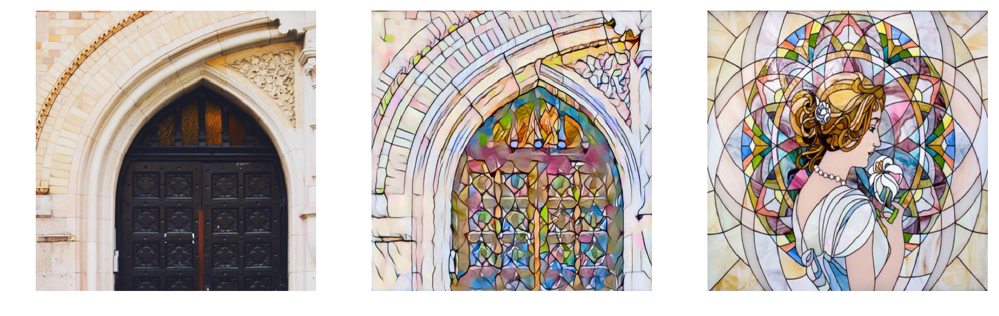

In [41]:
nstep, sw, cw = 1000, 10e12, 1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 100.0 style weight = 10000000.0


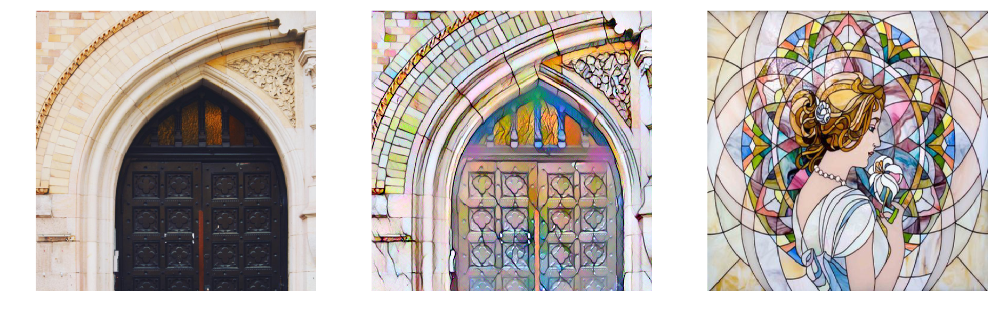

In [44]:
nstep, sw, cw = 1000, 10e6, 10e1
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 1000.0 style weight = 10000000.0


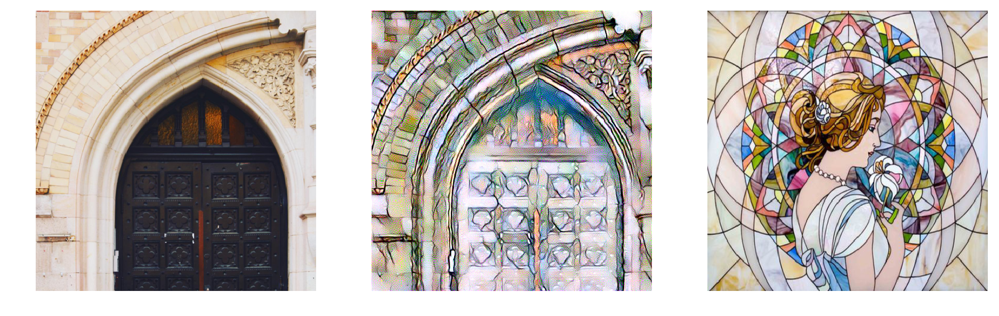

In [42]:
nstep, sw, cw = 1000, 10e6, 10e2
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 10000.0 style weight = 10000000.0


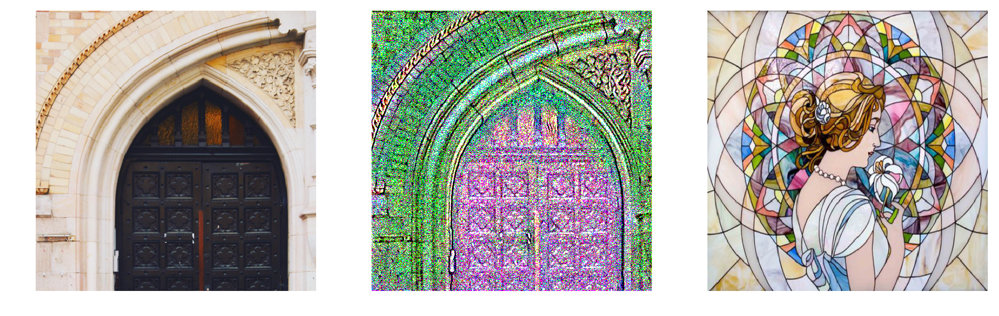

In [45]:
nstep, sw, cw = 1000, 10e6, 10e3
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 100000.0 style weight = 10000000.0


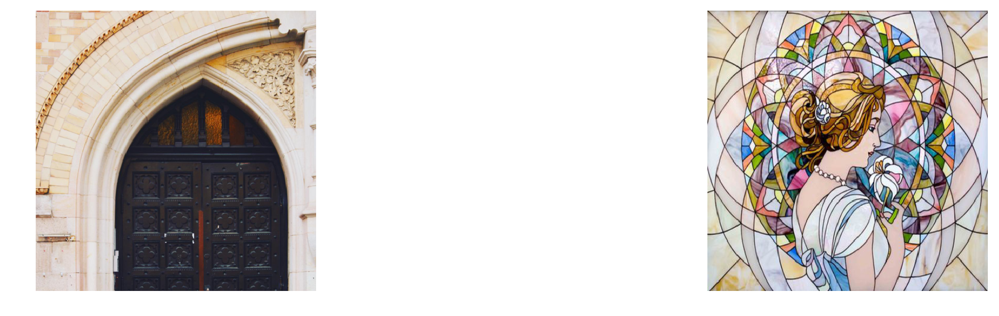

In [43]:
nstep, sw, cw = 1000, 10e6, 10e4
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 1000000.0 style weight = 10000000.0


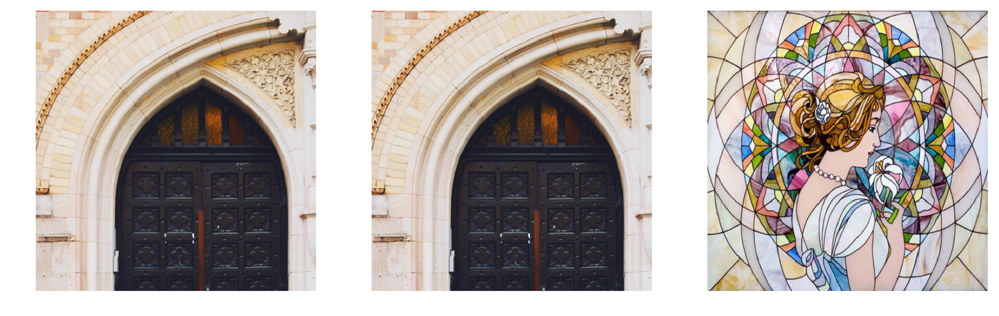

In [46]:
nstep, sw, cw = 1000, 10e6, 10e5
run_style_transfer('images/content/amber.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

### Conclusion
As style weight fixed as 10e6, when content weight decrease from 10e6 to 10e1, the output image changes from looking just the same as content image (conetent weight >= 10e5), to corrupted (content weight: 10e2 ~ 10e4), to sylized image(content weight: 1 ~ 10e1). When content weight fixed as 1, when style weight change from 10e6 to 10e12, the output images look alike, which means when style weight cross 10e6 as content weight equals 1, the result will not become more stylized. Based on visualization, we think when style weight equals 10e6, content weight equals 10e1, the output image captured the content and style feature best.

### Different choice of style image or content image

number of steps = 1000 content weight = 100.0 style weight = 10000000.0


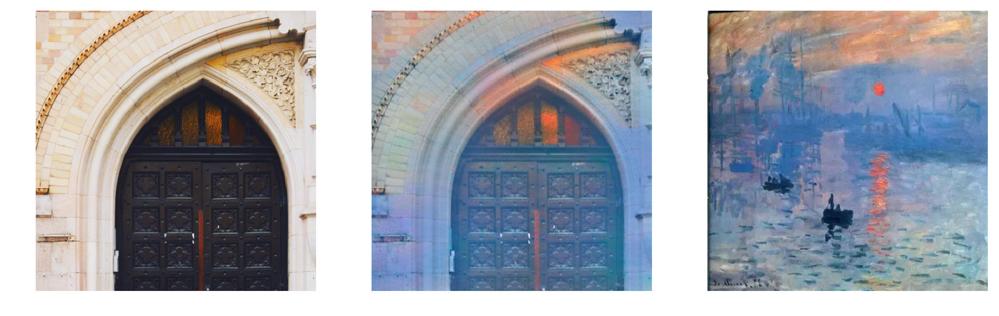

In [47]:
nstep, sw, cw = 1000, 10e6, 10e1
run_style_transfer('images/content/amber.jpg', 'images/style/sunrise.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 1 style weight = 10000000.0


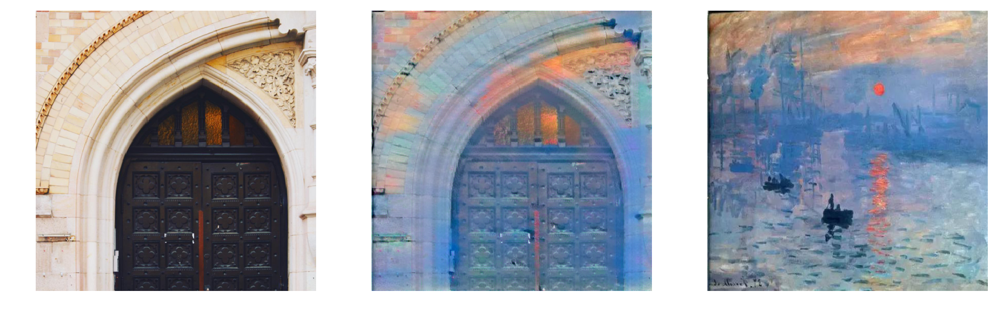

In [49]:
nstep, sw, cw = 1000, 10e6, 1
run_style_transfer('images/content/amber.jpg', 'images/style/sunrise.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 100.0 style weight = 10000000.0


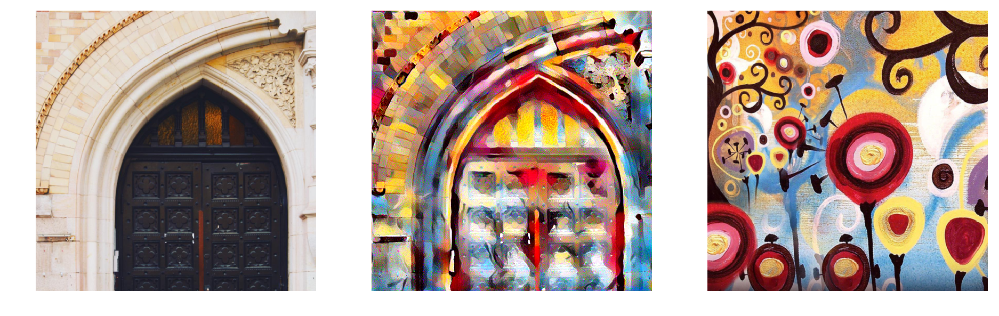

In [51]:
nstep, sw, cw = 1000, 10e6, 10e1
run_style_transfer('images/content/amber.jpg', 'images/style/candy.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 100.0 style weight = 1000000.0


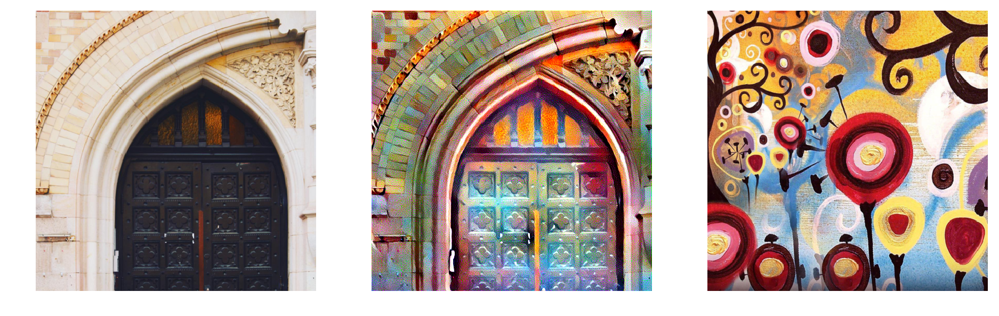

In [56]:
nstep, sw, cw = 1000, 10e5, 10e1
run_style_transfer('images/content/amber.jpg', 'images/style/candy.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 100.0 style weight = 10000000.0


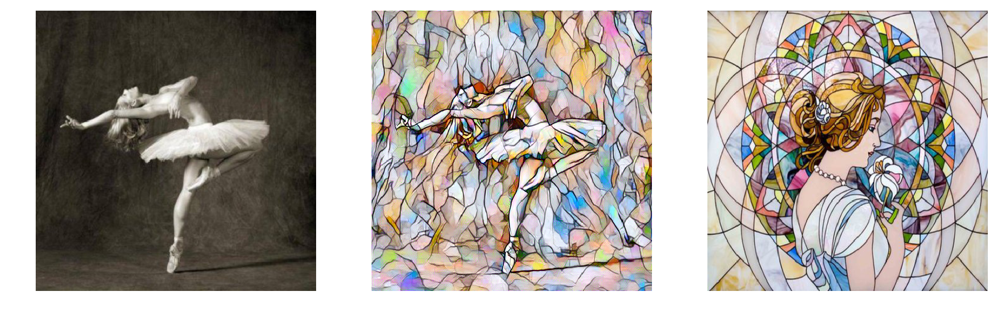

In [48]:
nstep, sw, cw = 1000, 10e6, 10e1
run_style_transfer('images/content/dancing.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

number of steps = 1000 content weight = 100.0 style weight = 10000000.0


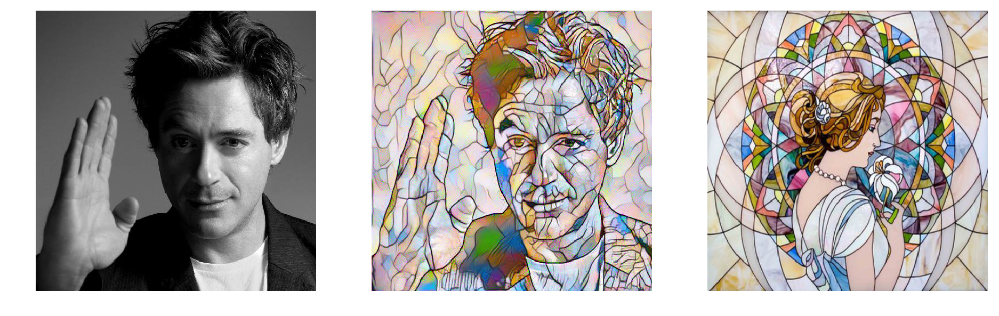

In [57]:
nstep, sw, cw = 1000, 10e6, 10e1
run_style_transfer('images/content/celebrity.jpg', 'images/style/mosaic.jpg', \
                   image_size, device, num_steps = nstep, style_weight=sw, content_weight=cw)
print("number of steps = " + str(nstep)+ " content weight = "+ str(cw)+ " style weight = "+ str(sw))

### Conclusion
Based on the above result, we can see that the stylized effect is sensitive to style image we choose. If we choose images like Monet's sunrise, the output image will become more difficult to stylize since the style image itself doesn't have such strong style. However, when we choose style image with more color contraction, with the same paramter settings, the output will look more stylized. In terms of content image, as is shown, the stylized effect doesn't vary significantly no matter what kind of image we choose as content image.